# Challenge 1 : Fire mapping - EY
## Data handling file
**Ordronneau Luca - Reberga Louis - Moncoutie Johan - Ettarian Julian**

This notebook describes the construction of our dataset, with the matching of polygons and linescans as well as the preprocessing of linescans and their masks.

### Import libraries and instantiate a datacube

In [ ]:
%matplotlib inline
import sys
import numpy as np
import pandas as pd
import geopandas as gpd
from datetime import datetime

from sklearn.utils import shuffle
import cv2

from datacube import Datacube
import matplotlib.pyplot as plt

sys.path.append("../scripts")
from dea_plotting import map_shapefile
from dea_spatialtools import xr_rasterize

import tensorflow as tf
import os
import random

from skimage.io import imread, imshow
from skimage.transform import resize

from numpy import expand_dims

from skimage import data, img_as_float
from skimage import exposure

dc = Datacube(app="Getting started")

seed = 1322

/env/lib/python3.6/site-packages/geopandas/_compat.py:110: UserWarning: The Shapely GEOS version (3.7.2-CAPI-1.11.0 ) is incompatible with the GEOS version PyGEOS was compiled with (3.9.0-CAPI-1.16.2). Conversions between both will be slow.
  shapely_geos_version, geos_capi_version_string


## Import variables

### Definition of global variables
- We define the size of the output image
- We define the number of extra images for each linescan

In [ ]:
height = 224
width = 224
nb_more_images = 8

### Import input variable: aerial linescan images

In [ ]:
linescan_datasets = dc.find_datasets(product='linescan')
linescan_datasets = sorted(linescan_datasets, key = lambda ds: (ds.center_time, ds.id))

### Import Target Variables: Fire Map Polygons

In [ ]:
vector_file = 'resources/fire_boundaries.shp'
gdf = gpd.read_file(vector_file)

### Filtering of composites and linescans
**Names of the composites or linescans that we have identified as degrading for the model, thanks to image analysis (median, mean, histogram of the pixels...)**

If they are in the ***very weird*** list. Linescans or composites will not be taken into account in the data, otherwise in the ***weird*** list, they will be taken into account but we will not do any augmentations.

In [ ]:
very_weird_linescans = [
    'WALHALLA_378_P1_201902041304_MGA94_55',
    'MACALISTER91_615_P1_201903051438_MGA94_55',
    'MACALISTER97_765_P1_201903131230_MGA94_55',
    'MACALISTER97_774_P1_201903141339_MGA94_55',
    'MACALISTER97_788_P1_201903151324_MGA94_55'
]

weird_linescans = [
    'MACALISTER97_680_P1_201903080512_MGA94_55',
    'MACALISTER_696_P1_201903091545_MGA94_55',
    'MACALISTER_697_P1_201903091555_MGA94_55',
    'MACALISTER_700_P1_201903091613_MGA94_55',
    'MACALISTER87_719_P1_201903100033_MGA94_55'
]

very_weird_composites = [
    'MACALISTER85_684_P1_201903080536_MGA94_55',
    'MACALISTER91_685_P1_201903080539_MGA94_55',
    'MACALISTER91_752_P1_201903111601_MGA94_55',
    'MACALISTER91_755_P1_201903111619_MGA94_55',
    'MACALISTER91_760_P1_201903111709_MGA94_55',
    'MACALISTER91_761_P1_201903111720_MGA94_55',
    'MACALISTER91_762_P1_201903111730_MGA94_55',
    'MACALISTER91_783_P1_201903141643_MGA94_55',
    'MACALISTER91_804_P1_201903161503_MGA94_55',
    'MACALISTER91_808_P1_201903161539_MGA94_55',
    'MACALISTER99_646_P1_201903070440_MGA94_55',
    'MACALISTER91_99_649_P1_201903070453_MGA94_55',
    'MACALISTER_696_P1_201903091545_MGA94_55',
    'MACALISTER_700_P1_201903091613_MGA94_55'
]

weird_composites = [
    'MACALISTER91_805_P1_201903161517_MGA94_55',
    'MACALISTER_699_P1_201903091610_MGA94_55',
    'MACALISTER_697_P1_201903091555_MGA94_55'
]

### Cleaning Up Polygon Dataset

In [ ]:
def clean_name(name):
    if name is None:
        res = None
    else:
        if name.upper()[-4::] == ".JPG":
            res = name.upper()[:-4].replace(' ','_')
        else:
            res = name.upper().replace(' ','_')
    return res

In [ ]:
gdf['SourceNameClean'] = gdf.apply(lambda row: clean_name(row.SourceName), axis=1)
gdf.dtUTC = gdf.apply(lambda row: datetime.strptime(row.dtUTC, '%Y-%m-%d %H:%M:%S'), axis=1)
gdf.dtLocal = gdf.apply(lambda row: datetime.strptime(row.dtLocal, '%Y-%m-%d %H:%M:%S'), axis=1)

### Number of linescan
We store the different linescans, trainings and tests in a different list

In [ ]:
train = pd.read_csv('resources/challenge1_train.csv', index_col='id')
train_labels = train['label'].unique().tolist()
test = pd.read_csv('resources/challenge1_test.csv', index_col='id')
test_labels = test['label'].unique().tolist()
print("There are "+str(len(train_labels))+" training linescans and " + str(len(test_labels)) + " test linescans")

There are 129 training linescans and 5 test linescans


In [ ]:
linescan_datasets_train = []
linescan_datasets_test = []
for i in range(len(linescan_datasets)):
    sample = linescan_datasets[i]
    fname = sample.metadata_doc['label']
    if fname in train_labels:
        linescan_datasets_train.append(sample) #129
    else:
        linescan_datasets_test.append(sample) #5

We determine the number of linescans with **more than 0 polygons** 

In [ ]:
original_linescans_size = 0
for i in range(len(linescan_datasets_train)):
    sample = linescan_datasets_train[i]
    fname = sample.metadata_doc['label']
    if sum(gdf.SourceNameClean == fname) != 0:
        original_linescans_size += 1
print("There are " + str(original_linescans_size + 1) + " linescans with more than 0 polygons")

There are 38 linescans with more than 0 polygons


### Composite Polygons

We get the list of all composites polygons

In [ ]:
composites = gdf[gdf.SourceName.str.upper().str.contains(",|&|(COMPOSITE)", na=False)]
composites['SourceNameClean'].unique().tolist()

/env/lib/python3.6/site-packages/pandas/core/strings.py:2001: UserWarning: This pattern has match groups. To actually get the groups, use str.extract.
  return func(self, *args, **kwargs)


['COMPOSITE_WALLHALLA_397,398_&_401_20190225_(1311_TO_1342HRS)',
 'MACALISTER_681_&_682,_(684_&_685_MINOR)_COMPOSITE_0517-0539HRS',
 'COMPOSITE_MACALISTER97_803,_806_&__807_1455-1532HRS',
 'MACALISTER91_751,_752,_755,_760,_761_&_762_COMPOSITE_1549-1730HRS',
 'MACALISTER91_766,767_&_770_COMPOSITE_1239-1314HRS',
 'MACALISTER91_775,_776,_779_&_783_COMPOSITE_1345-1643HRS',
 'MACALISTER91_789,_790_&_793_COMPOSITE_1330-1358HRS',
 'MACALISTER91_804,_805_&_808_COMPOSITE_1503-1539HRS',
 'MACALISTER91_646,648_&_649_COMPOSITE_-_0440HRS_TO_0453HRS',
 'MACALISTER_695,698_&_699_COMPOSITE_1542_-_1610HRS',
 'MACALISTER_696,697,700_-_1545-1613HRS',
 'COMPOSITE_WALLHALLA_380_&_381_20190206_(1347_&_1356HRS)']

### Method : Match composite polygons
We proceeded in **two stages**:
- A first step to extract the numbers associated with the linescans and put them in a list
- A second step to match this list with the linescans and thus create a list with the linescan names

In [ ]:
def composite_polygons(composite_name):
    composite_name = composite_name.replace("(", "")
    composite_name = composite_name.replace(")", "")
    split_underscore = composite_name.split("_")
    split_coma = []
    for s in split_underscore:
        split = s.split(",")
        for ss in split:
            split_coma.append(ss)
    result= []
    for e in split_coma:
        if e.isnumeric():
            new_e = int(e)
            if new_e < 1000:
                result.append(new_e)
    return result

def match_composite_linescan(l):
    result = []
    for i in range(len(linescan_datasets_train)):
        sample = linescan_datasets_train[i]
        fname = sample.metadata_doc['label']
        for e in l:
            if ("_"+str(e)+"_") in fname :
                result.append(fname)

    return result        

### Exemple : Match composite polygons

The list of the numbers of each linescan : [397, 398, 401]
The list of names of the linescans : ['WALHALLA_397_P1_201902251311_MGA94_55', 'WALHALLA_398_P1_201902251323_MGA94_55', 'WALHALLA_401_P1_201902251342_MGA94_55']
Rasterizing to match xarray.DataArray dimensions (2461, 2380)
Rasterizing to match xarray.DataArray dimensions (2580, 2399)
Rasterizing to match xarray.DataArray dimensions (2396, 2352)


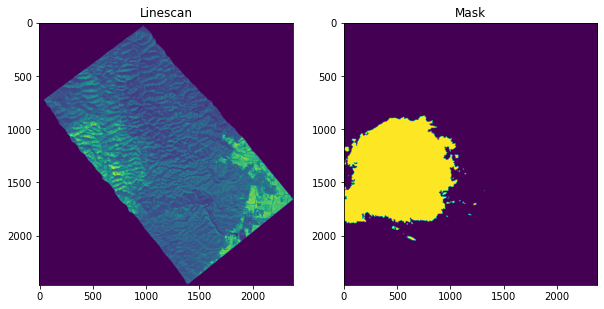

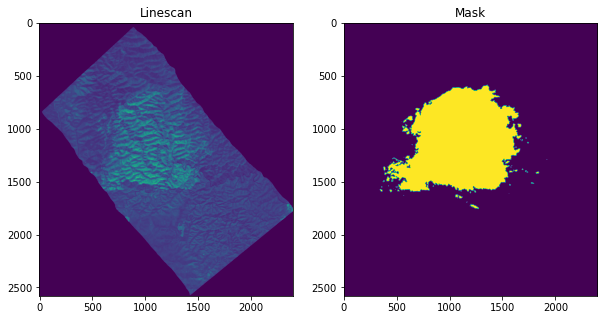

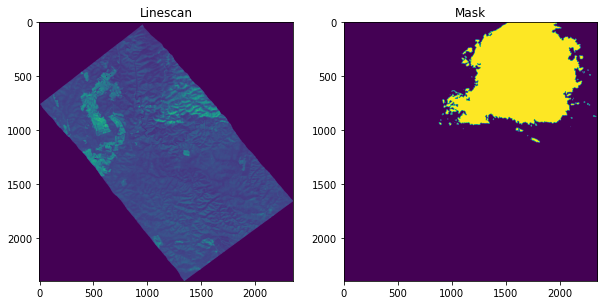

In [ ]:
composite_name = 'COMPOSITE_WALLHALLA_397,398_&_401_20190225_(1311_TO_1342HRS)'
ob = gdf.loc[gdf.SourceNameClean == composite_name]
linescans_list = composite_polygons(composite_name)
print("The list of the numbers of each linescan : "+str(linescans_list))
linescans_names_list = match_composite_linescan(linescans_list)
print("The list of names of the linescans : "+str(linescans_names_list))
for linescan in linescans_names_list:
    src = dc.load(product='linescan', label=linescan, output_crs='epsg:28355', resolution=(-10,10))
    image = src.linescan.values[0]
    mask = xr_rasterize(gdf=ob, da=src).values.astype(np.float32)
    
    f = plt.figure()
    f.set_figheight(10)
    f.set_figwidth(10)
    ax1 = f.add_subplot(1, 2, 1)
    ax1.title.set_text("Linescan")
    plt.imshow(image)
    ax2 = f.add_subplot(1, 2, 2)
    ax2.title.set_text("Mask")
    plt.imshow(mask)

We determine the number of linescans with composite polygons

In [ ]:
composite_size = 0

for composite in composites['SourceNameClean'].unique():
    ob = gdf.loc[gdf.SourceNameClean == composite]
    
    result = composite_polygons(composite)
    linescans = match_composite_linescan(result)
    
    for linescan in linescans:
        if linescan not in test_labels:
            composite_size += 1

print("There are " + str(composite_size + 1) + " linescans composite polygons")

There are 36 linescans composite polygons


Calculates the size of our dataset based on the augmented images and the images we don't use 

In [ ]:
linescans_size = (nb_more_images + 1) * (original_linescans_size - (len(weird_linescans)+len(very_weird_linescans))) + len(weird_linescans)
composite_size = (nb_more_images + 1) * (composite_size - (len(weird_composites) +len(very_weird_composites))) + len(weird_composites)
print("The size of our dataset is "+str(linescans_size + composite_size))

The size of our dataset is 413


## Pre Processing
Normalisation of linescans between 0 and 255

In [ ]:
def normalization(image):
    norm_img = np.zeros((image.shape[0],image.shape[1]))
    final_img = cv2.normalize(image,  norm_img, 0, 255, cv2.NORM_MINMAX)
    return final_img

Extraction of the linescan from the mask so as not to distort the prediction

In [ ]:
def extract_linescan_mask(image, mask):
    _, binary = cv2.threshold(image, 0, 255, cv2.THRESH_BINARY)
    kernelClose = cv2.getStructuringElement(cv2.MORPH_RECT,(100,100))
    binary = cv2.morphologyEx(binary, cv2.MORPH_CLOSE, kernelClose, iterations=2)
    for x in range(image.shape[0]): 
        for y in range(image.shape[1]):
            if (binary[x, y] == 0):
                mask[x, y] = 0
    return mask

Example of a linescan extraction from the mask

Rasterizing to match xarray.DataArray dimensions (2295, 1799)


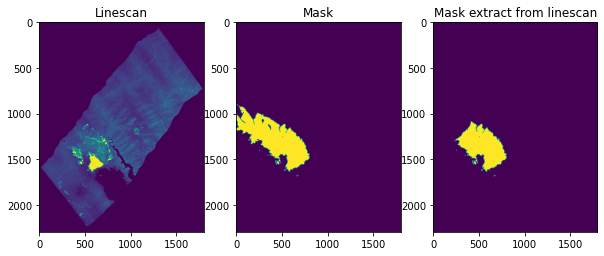

In [ ]:
sample = linescan_datasets[33]
fname = sample.metadata_doc['label']
ob = gdf.loc[gdf.SourceNameClean == fname]

src = dc.load(product='linescan', id=sample.id, output_crs='epsg:28355', resolution=(-10,10))
image = src.linescan.values[0]
mask = xr_rasterize(gdf=ob, da=src).values.astype('float')

f = plt.figure()
f.set_figheight(10)
f.set_figwidth(10)
ax1 = f.add_subplot(1, 3, 1)
ax1.title.set_text("Linescan")
plt.imshow(image)
ax2 = f.add_subplot(1, 3, 2)
ax2.title.set_text("Mask")
plt.imshow(mask)
ax3 = f.add_subplot(1, 3, 3)
ax3.title.set_text("Mask extract from linescan")
plt.imshow(extract_linescan_mask(image, mask))

### Functions that will be applied to images and masks when creating the dataset
**Image** :
- *Normalisation* : To have the same pixel range on each image
- *Gaussian Blur* : To ensure that spurious high-frequency information does not appear in the downsampled image
- *Resize / 3 channels* : To have the same size for each image and because our neural network needs this shape : (224, 224, 3)

**Mask**
- *Resize / Expand dims* : To have the same size for each image and because our neural network needs this shape : (224, 224, 1)

In [ ]:
def processing_image(image):
    image = normalization(image)
    image = cv2.GaussianBlur(image, (5, 5), 0)
    image = np.stack((image,)*3, axis=-1).astype(np.float32)
    dim = (width, height)
    image = cv2.resize(image, dim)
    image = image.astype('uint8')
    return image
    
def processing_mask(image, mask):
    mask = extract_linescan_mask(image, mask)
    dim = (width, height)
    mask = cv2.resize(mask, dim)
    mask = mask.astype(np.float32)
    mask = np.expand_dims(mask, axis=-1)
    return mask

### Image augmentations

We created 8 more images with a variation of **brightness**, **contrast** and **saturation**. We also flip our images **(Horizontal, Vertical, Transpose, Rotate)**.

This allows us to increase the size of our dataset with different images.

In [ ]:
from albumentations import HorizontalFlip, VerticalFlip, RandomRotate90, Transpose, RandomBrightnessContrast, RandomBrightness, Transpose, RandomContrast, Compose, ColorJitter, CLAHE

def image_augmentation(x, y):
    aug = HorizontalFlip(p=1.0)
    augmented = aug(image=x, mask=y)
    x1 = augmented["image"]
    y1 = augmented["mask"]

    aug = VerticalFlip(p=1)
    augmented = aug(image=x, mask=y)
    x2 = augmented["image"]
    y2 = augmented["mask"]

    aug = RandomRotate90(p=1)
    augmented = aug(image=x, mask=y)
    x3 = augmented['image']
    y3 = augmented['mask']

    aug = Transpose(p=1)
    augmented = aug(image=x, mask=y)
    x4 = augmented['image']
    y4 = augmented['mask']

    aug = RandomBrightnessContrast(brightness_limit=0.1, contrast_limit=0.1, p=1)
    augmented = aug(image=x, mask=y)
    x5 = augmented['image']
    y5 = augmented['mask']

    aug = Compose([RandomContrast(limit=0.1, p=1), RandomRotate90(p=1), VerticalFlip(p=1)])
    augmented = aug(image=x, mask=y)
    x6 = augmented['image']
    y6 = augmented['mask']
    
    aug = Compose([RandomBrightness(limit=0.1, p=1), RandomRotate90(p=1), HorizontalFlip(p=1.0)])
    augmented = aug(image=x, mask=y)
    x7 = augmented['image']
    y7 = augmented['mask']
    
    aug = Compose([ColorJitter(brightness=0.1, contrast=0.1, saturation=0.1, hue=0.1, p=1), VerticalFlip(p=1), Transpose(p=1)])
    augmented = aug(image=x, mask=y)
    x8 = augmented['image']
    y8 = augmented['mask']


    X = [x1, x2, x3, x4, x5, x6, x7, x8]
    Y = [y1, y2, y3, y4, y5, y6, y7, y8]
    
    return (X, Y)

### Example of processing on one linescan before launching on all linescans

Rasterizing to match xarray.DataArray dimensions (2295, 1799)


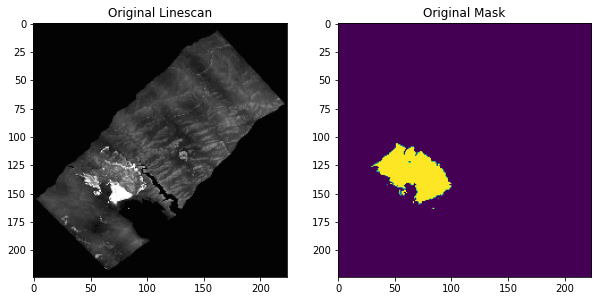

/env/lib/python3.6/site-packages/albumentations/augmentations/transforms.py:1727: FutureWarning: This class has been deprecated. Please use RandomBrightnessContrast
  FutureWarning,
/env/lib/python3.6/site-packages/albumentations/augmentations/transforms.py:1701: FutureWarning: This class has been deprecated. Please use RandomBrightnessContrast
  FutureWarning,


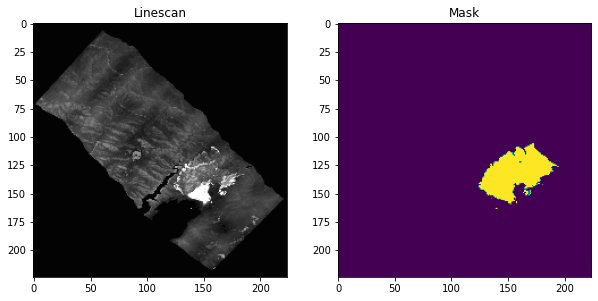

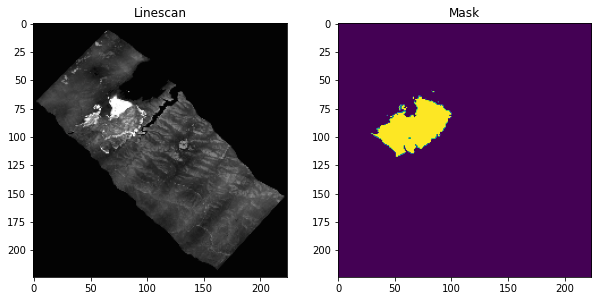

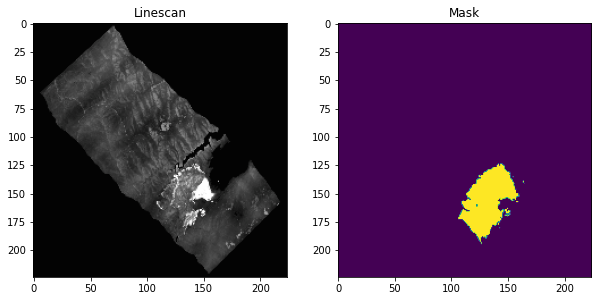

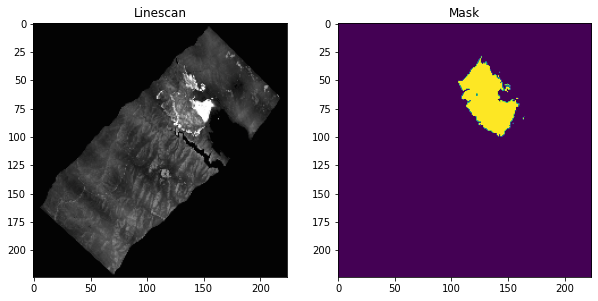

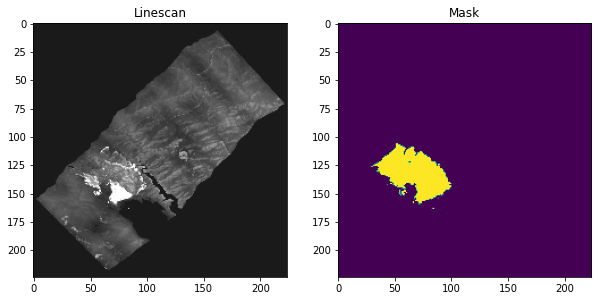

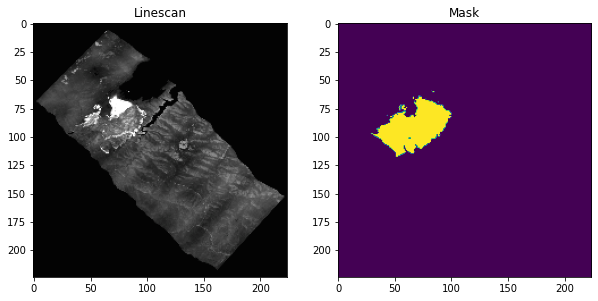

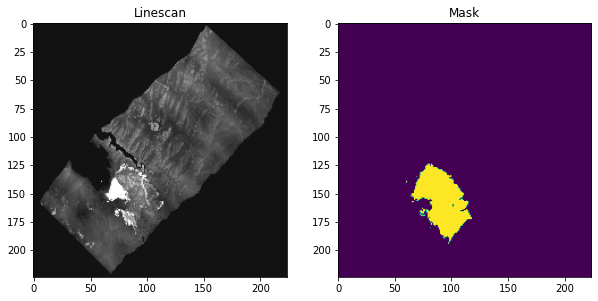

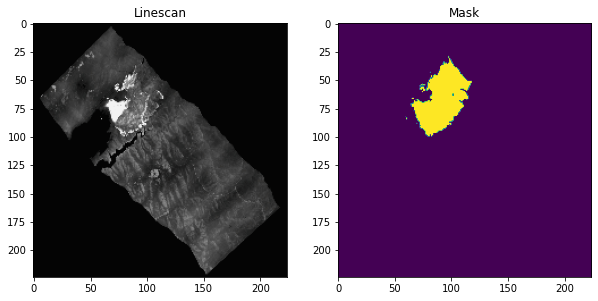

In [ ]:
sample = linescan_datasets[33]
fname = sample.metadata_doc['label']

ob = gdf.loc[gdf.SourceNameClean == fname]
src = dc.load(product='linescan', id=sample.id, output_crs='epsg:28355', resolution=(-10,10))

image = src.linescan.values[0]
mask = xr_rasterize(gdf=ob, da=src).values.astype('float32')

y = processing_mask(image, mask)
x = processing_image(image)
aug = CLAHE(clip_limit=1.0, tile_grid_size=(8, 8), p=1)
augmented = aug(image=x)
x = augmented['image']


f = plt.figure()
f.set_figheight(10)
f.set_figwidth(10)
ax1 = f.add_subplot(1, 2, 1)
ax1.title.set_text("Original Linescan")
plt.imshow(x)
ax2 = f.add_subplot(1, 2, 2)
ax2.title.set_text("Original Mask")
plt.imshow(np.squeeze(y))
plt.show(block=True)

X, Y = image_augmentation(x, y)

for i in range(len(X)):
    f = plt.figure()
    f.set_figheight(10)
    f.set_figwidth(10)
    ax1 = f.add_subplot(1, 2, 1)
    ax1.title.set_text("Linescan")
    plt.imshow(X[i])
    ax2 = f.add_subplot(1, 2, 2)
    ax2.title.set_text("Mask")
    plt.imshow(np.squeeze(Y[i]))
    plt.show(block=True)
    

## Construction of our dataset

Adding processed linescans with more than 0 polygons to the training dataset

In [ ]:
X_train1 = np.zeros((linescans_size, height, width, 3), dtype=np.uint8)
Y_train1 = np.zeros((linescans_size, height, width, 1), dtype=np.float32)

n = 0

for i in range(len(linescan_datasets_train)):
    sample = linescan_datasets_train[i]
    fname = sample.metadata_doc['label']
    
    if sum(gdf.SourceNameClean == fname) != 0 and (fname not in very_weird_linescans):
        
        ob = gdf.loc[gdf.SourceNameClean == fname]
        src = dc.load(product='linescan', id=sample.id, output_crs='epsg:28355', resolution=(-10,10))
        image = src.linescan.values[0]
        mask = xr_rasterize(gdf=ob, da=src).values.astype(np.float32)
        
        mask = processing_mask(image, mask)
        x = processing_image(image)
        aug = CLAHE(clip_limit=1.0, tile_grid_size=(8, 8), p=1)
        augmented = aug(image=x)
        image = augmented['image']
        
        X_train1[n] = image
        Y_train1[n] = mask
        
        n+=1
        
        if (fname not in weird_linescans):
            X, Y = image_augmentation(image, mask)
            for i in range(len(X)):
                X_train1[n] = X[i]
                Y_train1[n] = Y[i]
                n+=1
        

X_train1, Y_train1 = shuffle(X_train1, Y_train1)

Rasterizing to match xarray.DataArray dimensions (777, 1171)
Rasterizing to match xarray.DataArray dimensions (1297, 3333)
Rasterizing to match xarray.DataArray dimensions (1873, 2125)
Rasterizing to match xarray.DataArray dimensions (2052, 2196)
Rasterizing to match xarray.DataArray dimensions (2022, 2435)
Rasterizing to match xarray.DataArray dimensions (2295, 1799)
Rasterizing to match xarray.DataArray dimensions (1908, 2142)
Rasterizing to match xarray.DataArray dimensions (1963, 2224)
Rasterizing to match xarray.DataArray dimensions (1753, 1934)
Rasterizing to match xarray.DataArray dimensions (3314, 1683)
Rasterizing to match xarray.DataArray dimensions (2440, 2132)
Rasterizing to match xarray.DataArray dimensions (3981, 2973)
Rasterizing to match xarray.DataArray dimensions (3736, 3548)
Rasterizing to match xarray.DataArray dimensions (4124, 3915)
Rasterizing to match xarray.DataArray dimensions (3531, 2005)
Rasterizing to match xarray.DataArray dimensions (2855, 2389)
Rasterizi

Adding processed linescans with composite polygons to the training dataset

In [ ]:
X_train2 = np.zeros((composite_size, height, width, 3), dtype=np.uint8)
Y_train2 = np.zeros((composite_size, height, width, 1), dtype=np.float32)

n = 0

for composite in composites['SourceNameClean'].unique():
    ob = gdf.loc[gdf.SourceNameClean == composite]
    
    result = composite_polygons(composite)
    linescans = match_composite_linescan(result)
    
    for linescan in linescans:
        if linescan not in test_labels and (linescan not in very_weird_composites):
            src = dc.load(product='linescan', label=linescan, output_crs='epsg:28355', resolution=(-10,10))
            image = src.linescan.values[0]
            mask = xr_rasterize(gdf=ob, da=src).values.astype(np.float32)
            
            mask = processing_mask(image, mask)
            x = processing_image(image)
            aug = CLAHE(clip_limit=1.0, tile_grid_size=(8, 8), p=1)
            augmented = aug(image=x)
            image = augmented['image']
            
            X_train2[n] = image
            Y_train2[n] = mask
            
            n += 1
            
            if linescan not in weird_composites:
                X, Y = image_augmentation(image, mask)
                for i in range(len(X)):
                    X_train2[n] = X[i]
                    Y_train2[n] = Y[i]
                    n+=1

X_train2, Y_train2 = shuffle(X_train2, Y_train2) 

Rasterizing to match xarray.DataArray dimensions (2461, 2380)
Rasterizing to match xarray.DataArray dimensions (2580, 2399)
Rasterizing to match xarray.DataArray dimensions (2396, 2352)
Rasterizing to match xarray.DataArray dimensions (5321, 3249)
Rasterizing to match xarray.DataArray dimensions (4779, 3548)
Rasterizing to match xarray.DataArray dimensions (2706, 2357)
Rasterizing to match xarray.DataArray dimensions (3305, 2314)
Rasterizing to match xarray.DataArray dimensions (2703, 2290)
Rasterizing to match xarray.DataArray dimensions (5821, 3195)
Rasterizing to match xarray.DataArray dimensions (5300, 3263)
Rasterizing to match xarray.DataArray dimensions (5660, 3086)
Rasterizing to match xarray.DataArray dimensions (5275, 3305)
Rasterizing to match xarray.DataArray dimensions (5867, 3133)
Rasterizing to match xarray.DataArray dimensions (5255, 3327)
Rasterizing to match xarray.DataArray dimensions (5681, 3038)
Rasterizing to match xarray.DataArray dimensions (5084, 3663)
Rasteriz

We concatenate and have our final training dataset that we shuffle

In [ ]:
X_train = np.concatenate((X_train1, X_train2))
Y_train = np.concatenate((Y_train1, Y_train2))
X_train, Y_train = shuffle(X_train, Y_train)

Creation of test linescans dataset with the same pre processing as the training linescans

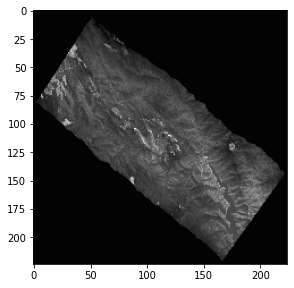

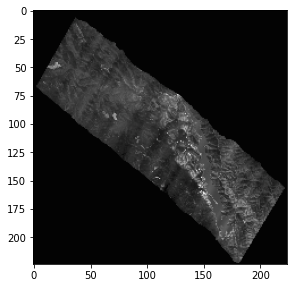

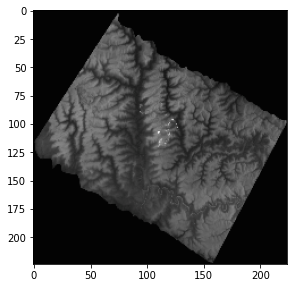

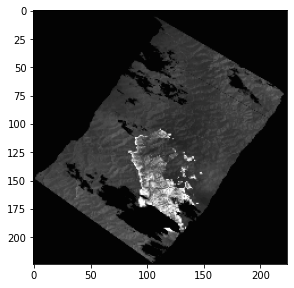

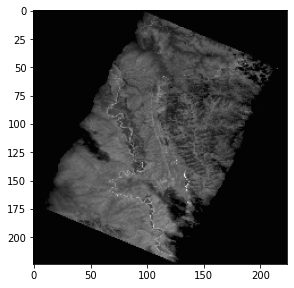

In [ ]:
X_test = np.zeros((len(linescan_datasets_test), height, width, 3), dtype=np.uint8)
n = 0
for i in range(len(linescan_datasets_test)):
    sample = linescan_datasets_test[i]
    fname = sample.metadata_doc['label']
    
    src = dc.load(product='linescan', id=sample.id, output_crs='epsg:28355', resolution=(-10,10))
    image = src.linescan.values[0]
    
    x = processing_image(image)
    aug = CLAHE(clip_limit=1.0, tile_grid_size=(8, 8), p=1)
    augmented = aug(image=x)
    image = augmented['image']
    
    X_test[n] = image

    f = plt.figure()
    f.set_figheight(10)
    f.set_figwidth(10)
    f.add_subplot(1, 2, 1)
    plt.imshow(X_test[n])
    plt.show(block=True)
    
    n += 1

We display the whole dataset

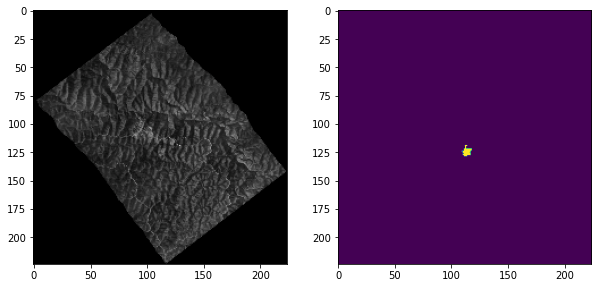

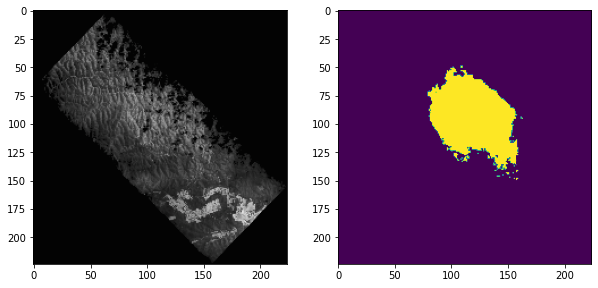

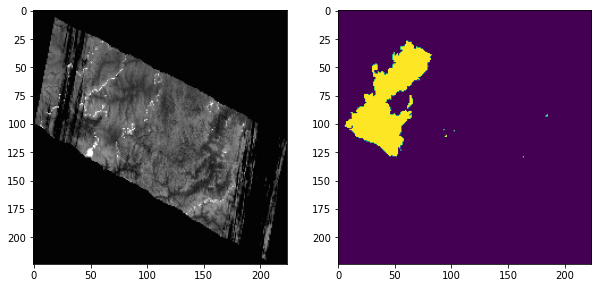

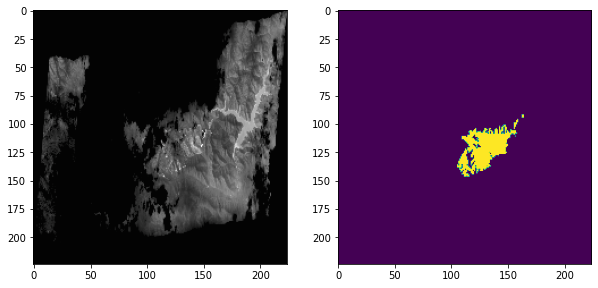

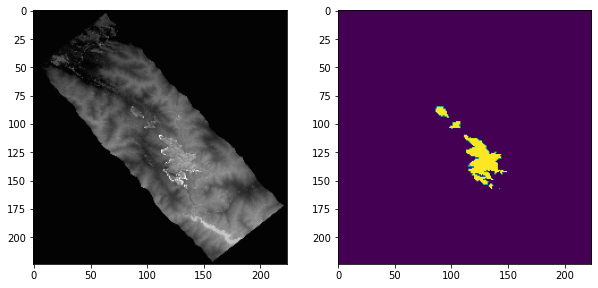

...

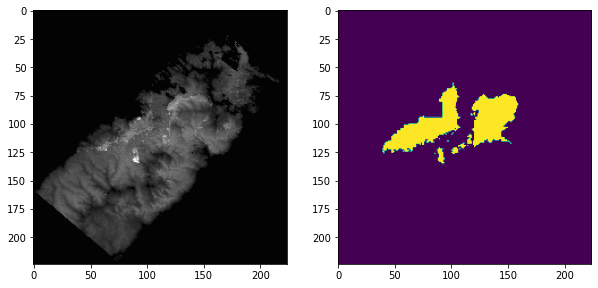

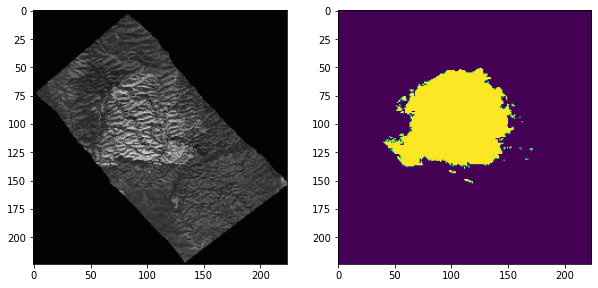

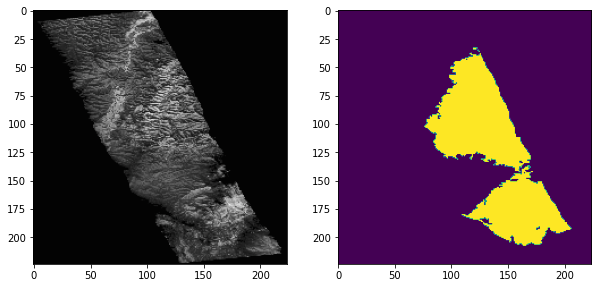

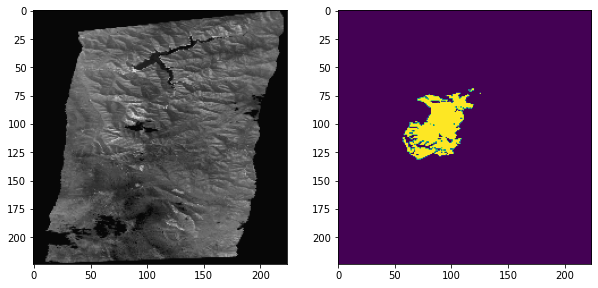

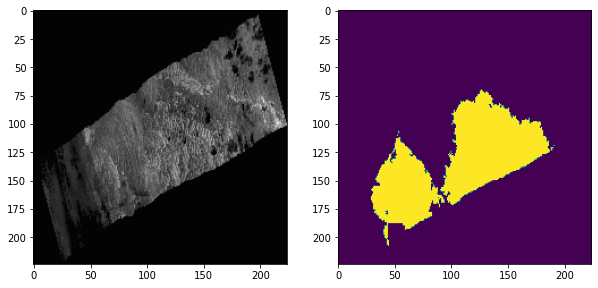

In [ ]:
for i in range(X_train.shape[0]):
    f = plt.figure()
    f.set_figheight(10)
    f.set_figwidth(10)
    f.add_subplot(1, 2, 1)
    plt.imshow(X_train[i])
    f.add_subplot(1, 2, 2)
    plt.imshow(np.squeeze(Y_train[i]))
    plt.show(block=True)

We save the training and test data. To then train the model

In [ ]:
np.save('X_TEST_413_semi_final', X_test)
np.savez_compressed('X_Y_TRAIN_413_semi_final', a=X_train, b=Y_train)